<a href="https://colab.research.google.com/github/ASKanse/Nuclei-Segmentation/blob/master/DSB_seg.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MULTI TASK LEARNING for Nuclei Segmentaion

In [ ]:
!nvidia-smi

Mon Jun 22 08:08:45 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.36.06    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   59C    P8    32W / 149W |      0MiB / 11441MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# The Model

In [ ]:
import torch
import torch.nn as nn

class res_unit(nn.Module):
  def __init__(self, D_in, D_out, stride):
      super(res_unit, self).__init__()
      self.bn1 = nn.BatchNorm2d(D_in)
      self.bn2 = nn.BatchNorm2d(int(D_out/4))
      self.relu = nn.ReLU(inplace=True)
      self.conv1 = nn.Conv2d(D_in, int(D_out/4), kernel_size=1, stride=1)
      self.conv2 = nn.Conv2d(int(D_out/4), int(D_out/4), kernel_size=3, padding = 1, stride=stride,bias=False)
      self.conv3 = nn.Conv2d(int(D_out/4), D_out, kernel_size=1, stride=1)
      self.shortcut = nn.Conv2d(D_in, D_out, kernel_size=3, padding = 1, stride=stride,bias=False)

  def forward(self, x):
      out = self.bn1(x)
      out = self.relu(out)
      out = self.conv1(out)
      out = self.bn2(out)
      out = self.relu(out)
      out = self.conv2(out)
      out = self.bn2(out)
      out = self.relu(out)
      out = self.conv3(out)
      sc = self.shortcut(x)
      out = out+sc
      out = self.relu(out)
      return out

class dense_unit(nn.Module):
  def __init__(self, D_in, D_out):
      super(dense_unit, self).__init__()
      self.dense = nn.Sequential(nn.BatchNorm2d(D_in),
      nn.ReLU(inplace=True),
      nn.Conv2d(D_in, 128, kernel_size=1, stride=1),
      nn.BatchNorm2d(128),
      nn.ReLU(inplace=True),
      nn.Conv2d(128, D_out, kernel_size=3, padding = 1, stride=1))
      self.shortcut = nn.Conv2d(D_in, D_out, kernel_size=3, padding = 1,stride=1,bias=False)
      self.relu = nn.ReLU(inplace=True)

  def forward(self, x):
      out = self.dense(x)
      sc = self.shortcut(x)
      out = out+sc
      out = self.relu(out)
      return out

class MTLSeg(nn.Module):
  def __init__(self):
    super(MTLSeg, self).__init__()
    self.bbc1 = nn.Conv2d(3, 64, kernel_size=7, stride=1, padding = 3, bias=False)
    self.bbru1 = res_unit(64,256,1)
    self.bbru2 = res_unit(256,256,1)
    self.bbru3 = res_unit(256,256,1) #1
    self.bbru4 = res_unit(256,512,2)
    self.bbru5 = res_unit(512,512,1)
    self.bbru6 = res_unit(512,512,1)
    self.bbru7 = res_unit(512,512,1) #2
    self.bbru8 = res_unit(512,1024,2)
    self.bbru9 = res_unit(1024,1024,1)
    self.bbru10 = res_unit(1024,1024,1)
    self.bbru11 = res_unit(1024,1024,1)
    self.bbru12 = res_unit(1024,1024,1)
    self.bbru13 = res_unit(1024,1024,1) #3
    self.bbru14 = res_unit(1024,2048,2)
    self.bbru15 = res_unit(2048,2048,1)
    self.bbru16 = res_unit(2048,2048,1)
    self.bbc2 = nn.Conv2d(2048, 1024, kernel_size=1, stride=1)

    self.ctup1 = nn.Upsample(scale_factor=2, mode='nearest')
    self.ctc1 = nn.Conv2d(1024, 128, kernel_size=3, padding = 1, stride=1, bias=False)
    self.ctdu1 = dense_unit(128,32)
    self.ctdu2 = dense_unit(32,32)
    self.ctdu3 = dense_unit(32,32)
    self.ctdu4 = dense_unit(32,32)
    self.ctdu5 = dense_unit(32,32)
    self.ctdu6 = dense_unit(32,32)
    self.ctdu7 = dense_unit(32,32)
    self.ctdu8 = dense_unit(32,32) #3
    self.ctc2 = nn.Conv2d(32, 128, kernel_size=1, stride=1, bias=False)
    self.ctup2 = nn.Upsample(scale_factor=2, mode='nearest')
    self.ctc3 = nn.Conv2d(128, 128, kernel_size=3, padding = 1, stride=1, bias=False)
    self.ctdu9 = dense_unit(128,32)
    self.ctdu10 = dense_unit(32,32)
    self.ctdu11 = dense_unit(32,32)
    self.ctdu12 = dense_unit(32,32) #2
    self.ctc4 = nn.Conv2d(32, 32, kernel_size=1, stride=1, bias=False)
    self.ctup3 = nn.Upsample(scale_factor=2, mode='nearest')
    self.ctc5 = nn.Conv2d(32, 32, kernel_size=3, padding=1, stride=1, bias=False) #1
    self.ctc6 = nn.Conv2d(32, 1, kernel_size=1, stride=1, bias=False)

    self.smup1 = nn.Upsample(scale_factor=2, mode='nearest')
    self.smc1 = nn.Conv2d(1024, 128, kernel_size=3, padding = 1, stride=1, bias=False)
    self.smdu1 = dense_unit(128,32)
    self.smdu2 = dense_unit(32,32)
    self.smdu3 = dense_unit(32,32)
    self.smdu4 = dense_unit(32,32)
    self.smdu5 = dense_unit(32,32)
    self.smdu6 = dense_unit(32,32)
    self.smdu7 = dense_unit(32,32)
    self.smdu8 = dense_unit(32,32) #3
    self.smc2 = nn.Conv2d(32, 128, kernel_size=1, stride=1, bias=False)
    self.smup2 = nn.Upsample(scale_factor=2, mode='nearest')
    self.smc3 = nn.Conv2d(128, 128, kernel_size=3, padding = 1, stride=1, bias=False)
    self.smdu9 = dense_unit(128,32)
    self.smdu10 = dense_unit(32,32)
    self.smdu11 = dense_unit(32,32)
    self.smdu12 = dense_unit(32,32) #2
    self.smc4 = nn.Conv2d(32, 32, kernel_size=1, stride=1, bias=False)
    self.smup3 = nn.Upsample(scale_factor=2, mode='nearest')
    self.smc5 = nn.Conv2d(32, 32, kernel_size=3, padding = 1, stride=1, bias=False) #1
    self.smc6 = nn.Conv2d(32, 1, kernel_size=1, stride=1, bias=False)

    self.skip1 = nn.Conv2d(256, 32, kernel_size=1, stride=1, bias=False)
    self.skip2 = nn.Conv2d(512, 32, kernel_size=1, stride=1, bias=False)
    self.skip3 = nn.Conv2d(1024, 32, kernel_size=1, stride=1, bias=False)
    self.sig = nn.Sigmoid()
  
  def forward(self, image):
    # back bone
    bbout = self.bbc1(image)
#    print('bbinit: ',bbout.shape)
    bbout = self.bbru1(bbout)
    bbout = self.bbru2(bbout)
    skip1 = self.bbru3(bbout) #1
    bbout = self.bbru4(skip1)
#    print('bbds1: ',bbout.shape)
    bbout = self.bbru5(bbout)
    bbout = self.bbru6(bbout)
    skip2 = self.bbru7(bbout) #2
    bbout = self.bbru8(skip2)
#    print('bbds2: ',bbout.shape)
    bbout = self.bbru9(bbout)
    bbout = self.bbru10(bbout)
    bbout = self.bbru11(bbout)
    bbout = self.bbru12(bbout)
    skip3 = self.bbru13(bbout) #3
    bbout = self.bbru14(skip3)
#    print('bbds3: ',bbout.shape)
    bbout = self.bbru15(bbout)
    bbout = self.bbru16(bbout)
    bbout = self.bbc2(bbout)
#    print('bbout: ',bbout.shape)

    # contour

    ctout = self.ctup1(bbout)
#    print('ctup1: ',ctout.shape)
    ctout = self.ctc1(ctout)
    ctout = self.ctdu1(ctout)
    ctout = self.ctdu2(ctout)
    ctout = self.ctdu3(ctout)
    ctout = self.ctdu4(ctout) 
    ctout = self.ctdu5(ctout) 
    ctout = self.ctdu6(ctout) 
    ctout = self.ctdu7(ctout) 
    ctout = self.ctdu8(ctout) #3
#    print('ctbeforeskip3: ',ctout.shape)
    tocat = self.skip3(skip3)
#    print(tocat.shape, ctout.shape)
#    ctout = torch.cat((ctout, tocat), dim=1)
    ctout = ctout + tocat
#    print('ctafterskip3: ',ctout.shape)
    ctout = self.ctc2(ctout)
    ctout = self.ctup2(ctout)
#    print('ctup2: ',ctout.shape)
    ctout = self.ctc3(ctout)
    ctout = self.ctdu9(ctout) 
    ctout = self.ctdu10(ctout)
    ctout = self.ctdu11(ctout)
    ctout = self.ctdu12(ctout) #2
#    print('ctbeforeskip2: ',ctout.shape)
    tocat = self.skip2(skip2)
#    print(tocat.shape, ctout.shape)
#    ctout = torch.cat((ctout, tocat), dim=1)
    ctout = ctout + tocat
#    print('ctafterskip1: ',ctout.shape)
    ctout = self.ctc4(ctout)
    ctout = self.ctup3(ctout)
#    print('ctup3: ',ctout.shape)
    ctout = self.ctc5(ctout) #1
#    print('ctbeforeskip1: ',ctout.shape)
    tocat = self.skip1(skip1)
#    print(tocat.shape, ctout.shape)
#    ctout = torch.cat((ctout, tocat), dim=1)
    ctout = ctout + tocat
#    print('ctafterskip1: ',ctout.shape)
    ctout = self.ctc6(ctout)
    ctout = self.sig(ctout)

    # segment

    smout = self.smup1(bbout)
#    print('smup1: ',smout.shape)
    smout = self.smc1(smout)
    smout = self.smdu1(smout)
    smout = self.smdu2(smout)
    smout = self.smdu3(smout)
    smout = self.smdu4(smout) 
    smout = self.smdu5(smout) 
    smout = self.smdu6(smout) 
    smout = self.smdu7(smout) 
    smout = self.smdu8(smout) #3
#    print('smbeforeskip3: ',smout.shape)
    tocat = self.skip3(skip3)
#    print(tocat.shape, smout.shape)
#    smout = torch.cat((smout, tocat), dim=1)
    smout = smout+tocat
#    print('smafterskip3: ',smout.shape)
    smout = self.smc2(smout)
    smout = self.smup2(smout)
#    print('smup2: ',smout.shape)
    smout = self.smc3(smout)
    smout = self.smdu9(smout) 
    smout = self.smdu10(smout)
    smout = self.smdu11(smout)
    smout = self.smdu12(smout) #2
#    print('smbeforeskip2: ',smout.shape)
    tocat = self.skip2(skip2)
#    print(tocat.shape, smout.shape)
#    smout = torch.cat((smout, tocat), dim=1)
    smout = smout+tocat
#    print('smafterskip2: ',smout.shape)
    smout = self.smc4(smout)
    smout = self.smup3(smout)
#    print('smup3: ',smout.shape)
    smout = self.smc5(smout) #1
#    print('smbeforeskip1: ',smout.shape)
    tocat = self.skip1(skip1)
#    print(tocat.shape, smout.shape)
#    smout = torch.cat((smout, tocat), dim=1)
    smout = smout+tocat
#    print('smafterskip1: ',smout.shape)
    smout = self.smc6(smout)
    smout = self.sig(smout)

    return ctout,smout

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import os
import cv2
import torchvision
import torchvision.transforms as transforms
import torchvision.transforms.functional as tF
from PIL import Image, ImageOps
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from pathlib import Path

#Data Loading

## Directory Parser

In [ ]:
def dirload():
    
  d1  = "./drive/My Drive/Neucleus_Seg/Train"
  d2 = "./drive/My Drive/Neucleus_Seg/Masks/cont"
  d3  = "./drive/My Drive/Neucleus_Seg/Masks/seg"
  
  train_img_paths  = []
  train_contour_paths  = []
  train_seg_paths  = []
  test_img_paths = []
  test_contour_paths = []
  test_seg_paths = []
  
  filenames = os.listdir(d1)
  n = len(filenames)
  
  added = 0
  for file in filenames:
    if file.endswith(".json"):
      filenames.remove(file)
  for i in range(n-1):
    f = random.choice(filenames)
    filenames.remove(f)
    if added <= 445:
      train_img_path = os.path.join(d1,f)
      train_contour_path = os.path.join(d2,f)
      train_seg_path = os.path.join(d3,f)
      train_img_paths.append(train_img_path)
      train_contour_paths.append(train_contour_path)
      train_seg_paths.append(train_seg_path)
    else:
      test_img_path = os.path.join(d1,f)
      test_contour_path = os.path.join(d2,f)
      test_seg_path = os.path.join(d3,f)
      test_img_paths.append(test_img_path)
      test_contour_paths.append(test_contour_path)
      test_seg_paths.append(test_seg_path)
    added+=1

  train_data = [train_img_paths, train_contour_paths, train_seg_paths]
  test_data = [test_img_paths, test_contour_paths, test_seg_paths]
  
  return [train_data , test_data]

## Pytorch Dataloader for model

In [ ]:
class trainLoader(Dataset):
  def __init__(self, transform):
    """
    Args:
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    [self.train_data , self.test_data] = dirload()
    self.transform = transform
        
  def __len__(self):
    return(len(self.train_data[0]))
  
  def __getitem__(self, idx):
    if torch.is_tensor(idx):
      idx = idx.tolist()
    img_name = self.train_data[0][idx]
    contour_name = self.train_data[1][idx]
    seg_name = self.train_data[2][idx]
    image = Image.open(img_name)
    contour = Image.open(contour_name).convert('L')
    segmask = Image.open(seg_name).convert('L')
    sample = {'image': image, 'contour': contour, 'segmask': segmask}
    
    if self.transform:
      sample = self.transform(sample)

    return sample

class testLoader(Dataset):
  def __init__(self, transform):
    """
    Args:
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    [self.train_data , self.test_data] = dirload()
    self.transform = transform
        
  def __len__(self):
    return(len(self.test_data[0]))
  
  def __getitem__(self, idx):
    if torch.is_tensor(idx):
      idx = idx.tolist()
    img_name = self.test_data[0][idx]
    contour_name = self.test_data[1][idx]
    seg_name = self.test_data[2][idx]
    image = Image.open(img_name)
    contour = Image.open(contour_name).convert('L')
    segmask = Image.open(seg_name).convert('L')
    sample = {'image': image, 'contour': contour, 'segmask': segmask}
    
    if self.transform:
      sample = self.transform(sample)

    return sample


# TransForms

In [ ]:
class RandomCrop(object):
  """Crop randomly the image in a sample.

  Args:
      output_size (tuple or int): Desired output size. If int, square crop
          is made.
  """

  def __init__(self, output_size):
    assert isinstance(output_size, (int, tuple))
    if isinstance(output_size, int):
      self.output_size = (output_size, output_size)
    else:
      assert len(output_size) == 2
      self.output_size = output_size

  def __call__(self, sample):
    image, contour, segmask = np.array(sample['image']), np.array(sample['contour']), np.array(sample['segmask'])

    h, w = image.shape[:2]
    new_h, new_w = self.output_size

    top = random.randint(0, h - new_h)
    left = random.randint(0, w - new_w)

    image = image[top: top + new_h,
                  left: left + new_w]
    contour = contour[top: top + new_h,
                  left: left + new_w]
    segmask = segmask[top: top + new_h,
                  left: left + new_w]
    
    image = Image.fromarray(image)
    contour = Image.fromarray(contour)
    segmask = Image.fromarray(segmask)


    return {'image': image, 'contour': contour, 'segmask': segmask}

class AffineTrans(object):
  def __init__(self, degrees, translate):
    self.degrees = degrees
    self.translate = translate
  
  def __call__(self, sample):
    image, contour, segmask = sample['image'], sample['contour'], sample['segmask']
    TF = transforms.RandomAffine(degrees = self.degrees, translate=self.translate)
    image = TF(image)
    contour = TF(contour)
    segmask = TF(segmask)
    return {'image': image, 'contour': contour, 'segmask': segmask}
    
class Flip(object):   
  def __call__(self, sample):
    image, contour, segmask = sample['image'], sample['contour'], sample['segmask']
    if random.random() > 0.5:
        image = tF.hflip(image)
        contour = tF.hflip(contour)
        segmask = tF.hflip(segmask)
    if random.random() > 0.5:
        image = tF.vflip(image)
        contour = tF.vflip(contour)
        segmask = tF.vflip(segmask)
    
    return {'image': image, 'contour': contour, 'segmask': segmask}

class ToTensor(object):
  """Convert ndarrays in sample to Tensors."""

  def __call__(self, sample):
    image, contour, segmask = np.array(sample['image']), np.array(sample['contour']), np.array(sample['segmask'])

    # swap color axis because
    # numpy image: H x W x C
    # torch image: C X H X W
    image = image.transpose((2, 0, 1))
    contour = contour.reshape(-1, 256, 256)
    segmask = segmask.reshape(-1, 256, 256)
    return {'image': torch.from_numpy(image),
            'contour': torch.from_numpy(contour),
            'segmask': torch.from_numpy(segmask)}

composed = transforms.Compose([RandomCrop(256),
                               Flip(),                        
                               ToTensor()])

In [ ]:
train_dat = trainLoader(composed)
test_dat = testLoader(composed)

traindataloader = DataLoader(train_dat, batch_size=2,
                        shuffle=True, num_workers=2)
testdataloader = DataLoader(test_dat, batch_size=1,
                        shuffle=True, num_workers=2)

for i_batch, sample_batched in enumerate(traindataloader):
  print(i_batch, sample_batched['image'].size(),sample_batched['contour'].size(),sample_batched['segmask'].size())
  if i_batch == 3:
    break

0 torch.Size([2, 3, 256, 256]) torch.Size([2, 1, 256, 256]) torch.Size([2, 1, 256, 256])
1 torch.Size([2, 3, 256, 256]) torch.Size([2, 1, 256, 256]) torch.Size([2, 1, 256, 256])
2 torch.Size([2, 3, 256, 256]) torch.Size([2, 1, 256, 256]) torch.Size([2, 1, 256, 256])
3 torch.Size([2, 3, 256, 256]) torch.Size([2, 1, 256, 256]) torch.Size([2, 1, 256, 256])


# Config and Training

In [ ]:
model = MTLSeg()

try:
    model = torch.load(Path('./drive/My Drive/Neucleus_Seg/mtlseg.pth'))
except:
    pass

lr = 0.0002
epoch = 100
bce = nn.BCELoss()
mse = nn.MSELoss()

optimizer = torch.optim.Adam(model.parameters(),lr=lr)

def dice_loss(pred,target):
    numerator = 2 * torch.sum(pred * target)
    denominator = torch.sum(pred + target)
    return 1 - (numerator + 1) / (denominator + 1)

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
#model.half()
#for layer in model.modules():
#  if isinstance(layer, nn.BatchNorm2d):
#    layer.float()
print(device)
model.to(device)

cuda:0


MTLSeg(
  (bbc1): Conv2d(3, 64, kernel_size=(7, 7), stride=(1, 1), padding=(3, 3), bias=False)
  (bbru1): res_unit(
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1))
    (shortcut): Conv2d(64, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  )
  (bbru2): res_unit(
    (bn1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1))
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=

In [ ]:
for i in range(epoch):
  if i%5 == epoch-1:
    torch.save(model,Path('./drive/My Drive/Neucleus_Seg/mtlseg.pth'))
  for _,sample_batch in enumerate(traindataloader):
    optimizer.zero_grad()
    x = sample_batch['image'].to(device=device, dtype=torch.float)#.half()
    y_1 = (sample_batch['contour']/255.0).to(device=device, dtype=torch.float)#.half()
    y_2 = (sample_batch['segmask']/255.0).to(device=device, dtype=torch.float)#.half()
    y1,y2 = model.forward(x)
    loss11 = bce(y1,y_1)
    loss12 = dice_loss(y1,y_1)
    loss21 = bce(y2,y_2)
    loss22 = dice_loss(y2,y_2)
    loss = loss11+loss12+loss21+loss22
    loss.backward(retain_graph=True)
    optimizer.step()

    if _ % 50 == 0:
      print(i)
      print(loss.item())
      # utils.save_image(x.cpu().data,Path("./result/original_image_{}_{}.png".format(i,_)))
      # utils.save_image(y_.cpu().data,Path("./result/label_image_{}_{}.png".format(i,_)))
      # utils.save_image(y.cpu().data,Path("./result/gen_image_{}_{}.png".format(i,_)))

0
0.7214781641960144
0
1.1189920902252197
0
2.3146018981933594
0
1.9627984762191772
0
1.5442986488342285
1
1.5740916728973389
1
0.9373489022254944
1
0.5881152749061584
1
0.9535201787948608
1
0.9236425757408142
2
1.5398433208465576
2
1.427074909210205
2
0.7096703052520752
2
1.4667608737945557
2
0.8484119176864624
3
0.9093062877655029
3
0.8569961190223694
3
1.1428442001342773
3
0.8928725719451904
3
0.6794687509536743
4
1.1118831634521484
4
0.734438419342041
4
0.9292738437652588
4
0.670652449131012
4
1.0615856647491455
5
1.0429275035858154
5
0.6978164911270142
5
0.7615020871162415
5
1.2227931022644043
5
0.666544497013092
6
0.6703718304634094
6
0.8281921148300171
6
1.2928156852722168
6
0.8808594346046448
6
1.1009048223495483
7
0.4410160779953003
7
1.192495584487915
7
1.0574382543563843
7
1.3205020427703857
7
0.7861486673355103
8
0.8394208550453186
8
0.7705311179161072
8
1.0011687278747559
8
0.9446377158164978
8
1.1219857931137085
9
1.1842913627624512
9
0.433677613735199
9
0.956488132476806

In [ ]:
torch.save(model,Path('./drive/My Drive/Neucleus_Seg/mtlseg.pth'))

In [ ]:
minibatch = iter(testdataloader).next()
ctout, smout = model(minibatch['image'].to(device=device, dtype=torch.float))

y_1 = (minibatch['contour']/255.0).to(device=device, dtype=torch.float)#.half()
y_2 = (minibatch['segmask']/255.0).to(device=device, dtype=torch.float)#.half()

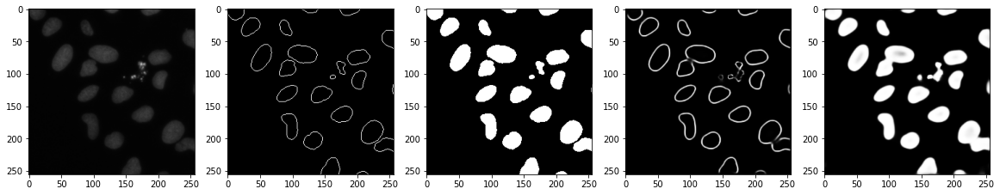

In [ ]:

ctim = np.array(ctout[0].cpu().detach())
smim = np.array(smout[0].cpu().detach())
ctim = ctim.reshape(256,256)
smim = smim.reshape(256,256)

im = np.array(minibatch['image'][0].detach())
f = plt.figure(figsize=(20, 20))
plt.subplot(1, 5, 1)
plt.imshow(im.transpose(1, 2, 0))
plt.subplot(1, 5, 2)
plt.imshow((minibatch['contour'][0]/255.0).reshape(256,256), cmap='gray')
plt.subplot(1, 5, 3)
plt.imshow((minibatch['segmask'][0]/255.0).reshape(256,256), cmap='gray')
plt.subplot(1, 5, 4)
plt.imshow(ctim, cmap='gray')
plt.subplot(1, 5, 5)
plt.imshow(smim, cmap='gray')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


IoU Score 1: 0.019683906010219028
IoU Score 2: 0.13724688121250697
PQ Score : 0.6871385248246201


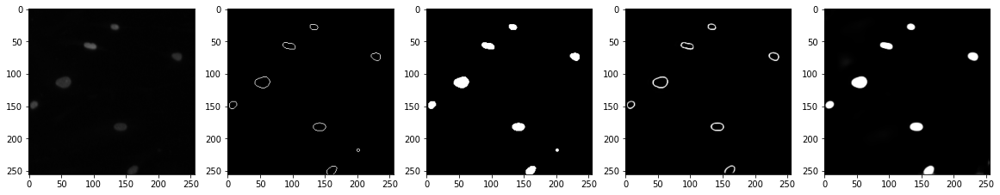

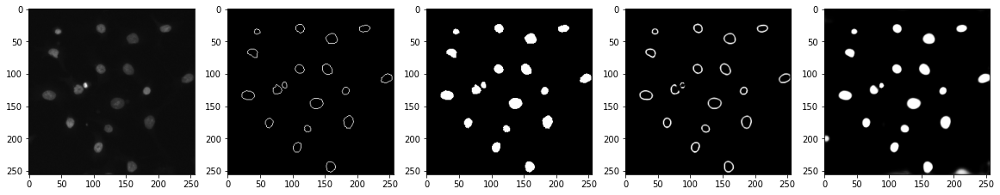

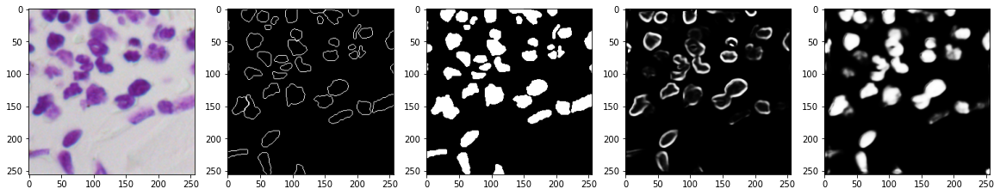

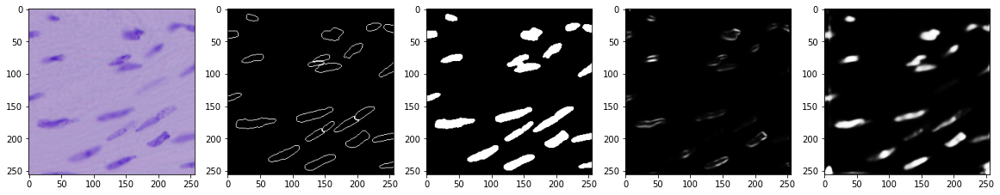

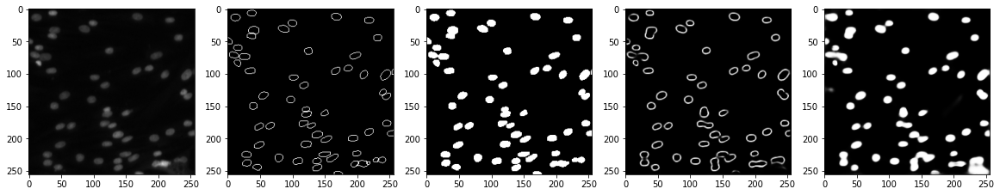

...

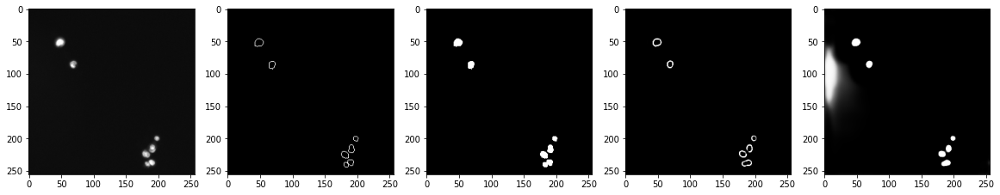

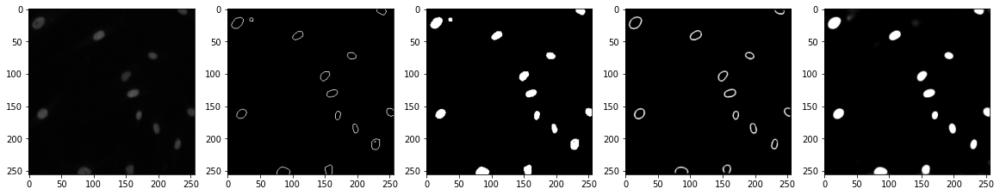

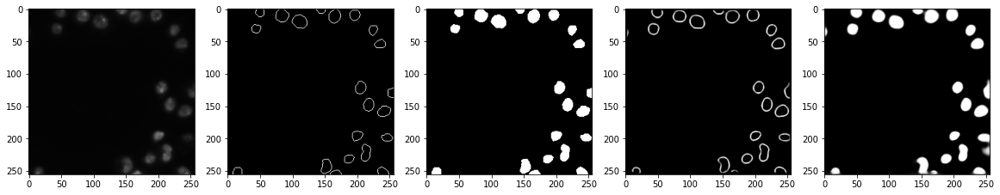

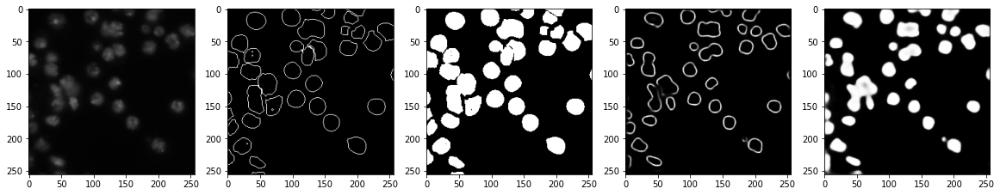

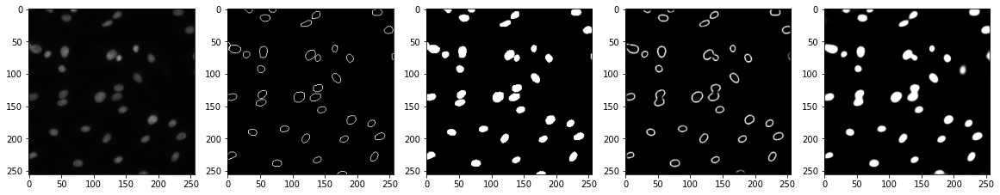

In [ ]:
iou_score1 = 0
iou_score2 = 0
pq_score = 0
i = 0
for _,sample_batch in enumerate(testdataloader):
    x = sample_batch['image']
    y_1 = (sample_batch['contour']/255.0)
    y_2 = (sample_batch['segmask']/255.0)
    y1, y2 = (model.forward(x.to(device=device, dtype = torch.float)))
    y1,y2 = y1.cpu(),y2.cpu()
    ctim = np.array(y1[0].detach())
    smim = np.array(y2[0].detach())
    ctim = ctim.reshape(256,256)
    smim = smim.reshape(256,256)

    im = np.array(sample_batch['image'][0].detach())
    f = plt.figure(figsize=(20, 20))
    plt.subplot(1, 5, 1)
    plt.imshow(im.transpose(1, 2, 0))
    plt.subplot(1, 5, 2)
    plt.imshow((sample_batch['contour'][0]/255.0).reshape(256,256), cmap='gray')
    plt.subplot(1, 5, 3)
    plt.imshow((sample_batch['segmask'][0]/255.0).reshape(256,256), cmap='gray')
    plt.subplot(1, 5, 4)
    plt.imshow(ctim, cmap='gray')
    plt.subplot(1, 5, 5)
    plt.imshow(smim, cmap='gray')
    #plt.savefig('./drive/My Drive/Neucleus_Seg/results'+str(i)+'.png', bbox_inches='tight')
    intersection1 = np.logical_and(y_1.detach().numpy(), y1.detach().numpy())
    intersection2 = np.logical_and(y_2.detach().numpy(), y2.detach().numpy())
    union1 = np.logical_or(y_1.detach().numpy(), y1.detach().numpy())
    union2 = np.logical_or(y_2.detach().numpy(), y2.detach().numpy())

    iou_score1 += np.sum(intersection1) / np.sum(union1)
    iou_score2 += np.sum(intersection2) / np.sum(union2)
    pq_score += np.sum(iou_score2)/(np.sum(intersection2)+((0.5)*np.sum(intersection2)))
    i+=1
    
iou_score1 /= len(test_dat)
iou_score2 /= len(test_dat)
#dice_score = (2*iou_score)/(1+iou_score)
print('IoU Score 1:', iou_score1)
print('IoU Score 2:', iou_score2)
print('PQ Score :', pq_score)
#print('Dice Score :', dice_score)